# Bechdel Test on Youtube Trailers 
Test for Observatoire des Images

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import _pickle as pickle
from PIL import Image
import os

import requests
import cv2

%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../../")

# Get trailer from Youtube
Inspired from https://huggingface.co/spaces/Karwasze/Whisper-ASR-youtube-subtitles/blob/main/app.py

**Trailers from French box office are :** 
- Spider-Man : No Way Home
- Top Gun : Maverick
- Les Minions 2 : il était une fois Gru
- Jurassic World : le monde d’après
- Doctor strange in the multiverse of madness
- Encanto, la fantastique famille Madrigal
- The Batman
- Thor : Love and Thunder
- Les animaux fantastiques 3 : le secret de Dumbledore
- Tous en scène 2
- Uncharted
- Les Tuche 4 - https://www.youtube.com/watch?v=TCTtdSuj2eo&ab_channel=FilmsActu
- Qu’est-ce qu’on a tous fait au bon dieu ?

In [8]:
from pytube import YouTube

def get_youtube(video_url):
    yt = YouTube(video_url)
    abs_video_path = yt.streams.filter(progressive=True, file_extension='mp4').order_by('resolution').desc().first().download()
    print(abs_video_path)
    return abs_video_path

In [9]:
video_url = "https://www.youtube.com/watch?v=TCTtdSuj2eo&ab_channel=FilmsActu" #Tuche 4

In [10]:
video_path = get_youtube(video_url)

C:\git\bechdelai\notebooks\video\LES TUCHE 4 Bande Annonce Officielle (2021).mp4


In [7]:
! start .

# Loading video

In [311]:
import bechdelai
from bechdelai.video.video import Video

video_path = "LES TUCHE 4 Bande Annonce Officielle (2021).mp4"

video = Video(path = video_path,max_seconds = None,frame_rate = 1)

video.replay()

  0%|          | 0/118 [00:00<?, ?it/s]

interactive(children=(Play(value=0, description='Press play', interval=500, max=117), Output()), _dom_classes=…

IntSlider(value=0, max=117)

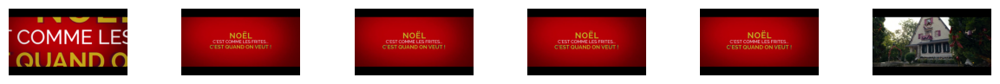

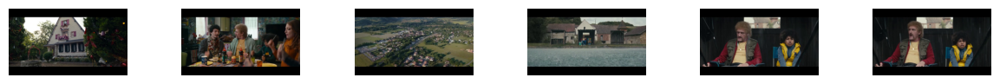

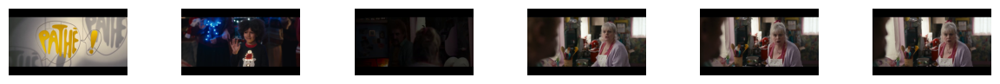

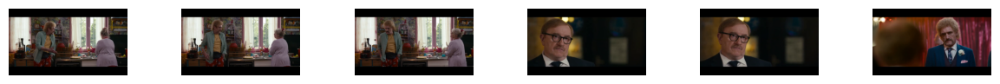

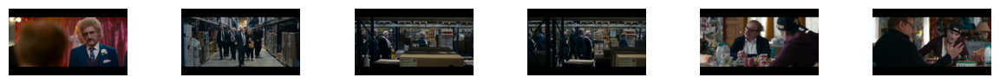

...

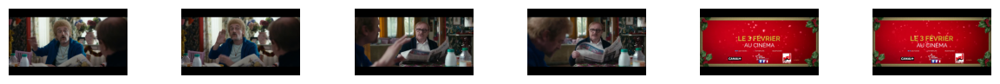

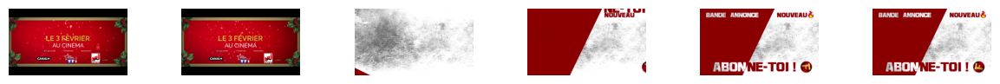

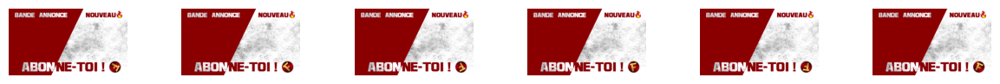

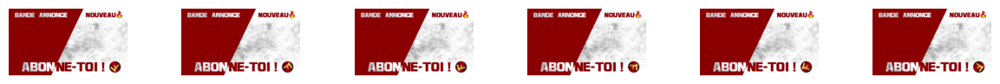

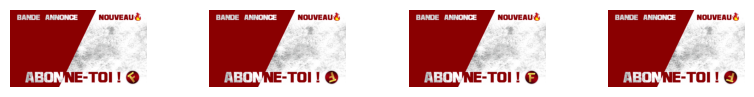

In [312]:
video.show_frames()

# Finding all faces and predicting gender

In [168]:
from bechdelai.image.face_detection import FacesDetector
from bechdelai.image.gender_detection import GenderDetector

In [169]:
fd = FacesDetector()
gd = GenderDetector()

Loading CLIP model


## Test on one frame

For one frame we can use RetinaFace easily for higher accuracy

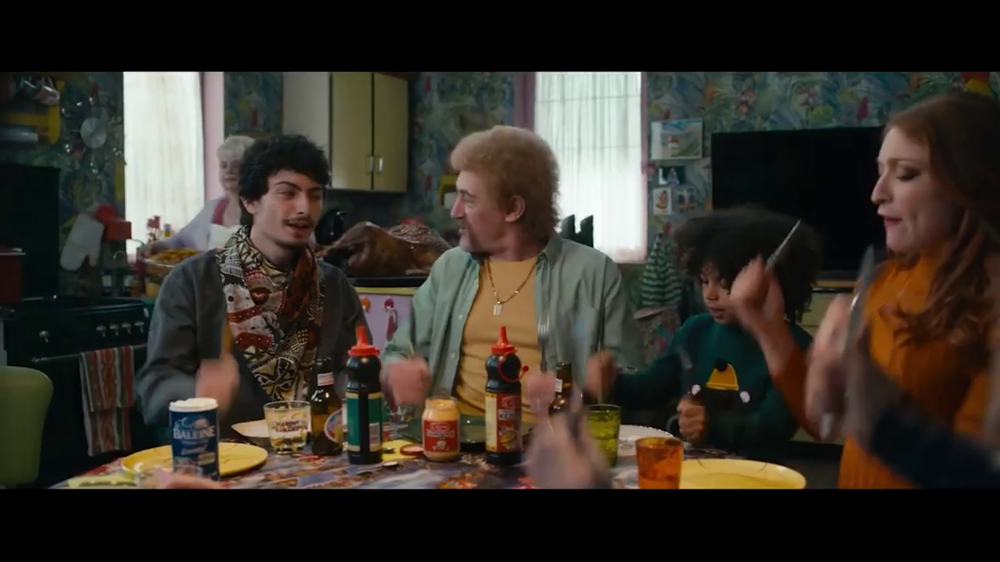

In [198]:
img = video.frames[7]
img

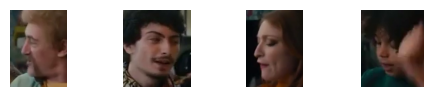

In [199]:
rois,faces = fd.detect(img.array,method = "retinaface",padding = 20)
fd.show_all_faces(faces)

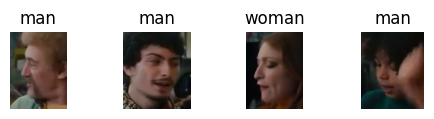

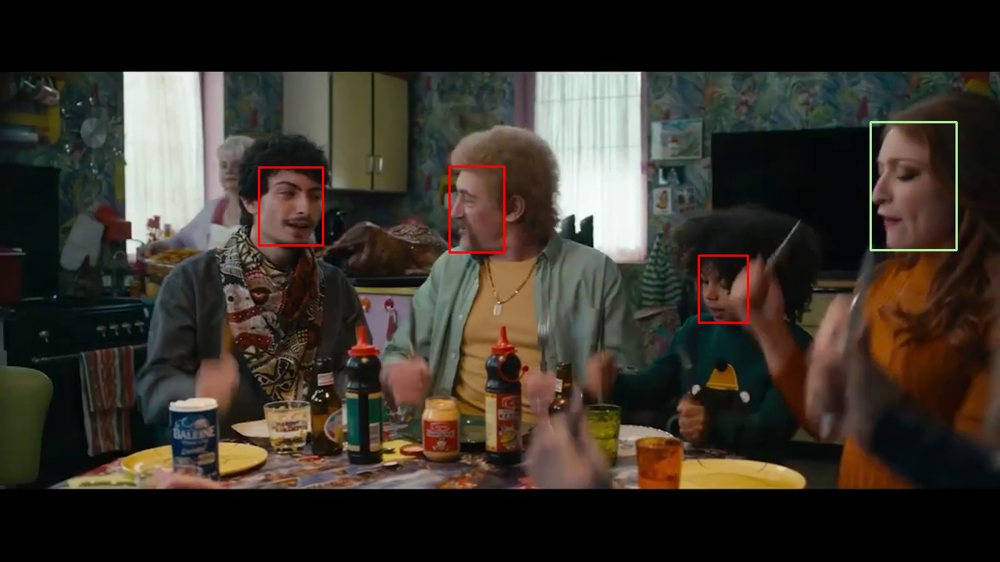

In [200]:
probas = gd.predict(faces)
fd.show_all_faces(faces,titles = probas["gender"])
fd.show_faces_on_image(img.array,rois,genders = probas["gender"])

## Application on all frames of the movie sample

  0%|          | 0/16 [00:00<?, ?it/s]

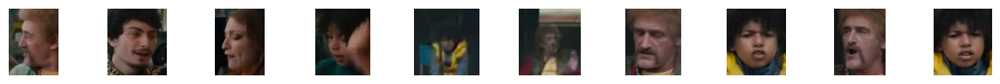

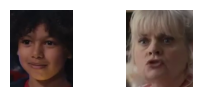

In [201]:
faces,faces_metadata = fd.detect_many(video,method = "retinaface",padding = 20)
fd.show_all_faces(faces)

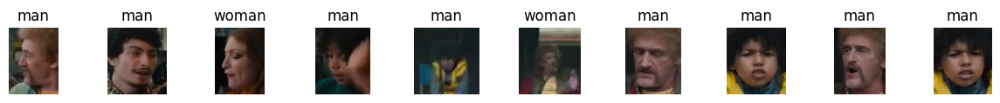

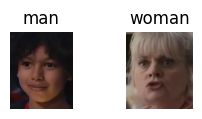

In [202]:
probas,annotations = gd.predict(faces,faces_metadata)
video.reset_annotations()
video.annotate(annotations)
fd.show_all_faces(faces,titles = probas["gender"].tolist())

In [184]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=60), Output()), _dom_classes=(…

IntSlider(value=0, max=60)

### Regroup faces together

In [189]:
# video.resize(width = 500)

In [138]:
faces,faces_metadata = fd.detect_many(video,method = "ssd")

  0%|          | 0/126 [00:00<?, ?it/s]

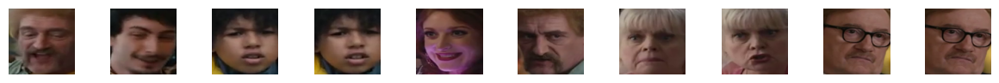

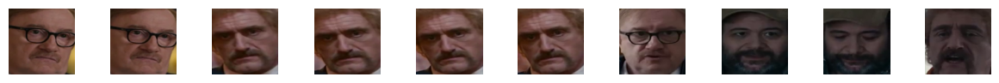

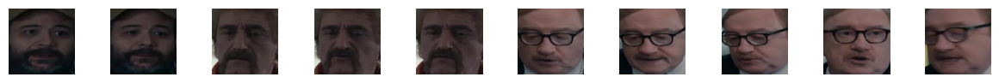

<Figure size 1500x100 with 0 Axes>

In [139]:
fd.show_all_faces(faces)

In [12]:
embeddings = []

for face in tqdm(faces):
    with HiddenPrints():
        emb = DeepFace.represent(np.array(face),model_name = "ArcFace",enforce_detection=False)
    embeddings.append(np.array(emb))
    
embeddings = np.stack(embeddings)

  0%|          | 0/30 [00:00<?, ?it/s]

In [13]:
embeddings2D = fd.reduce_embeddings(embeddings)


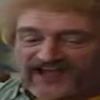
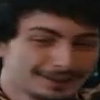
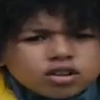
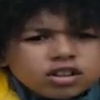
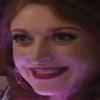
...
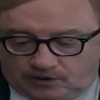
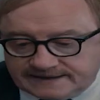
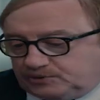
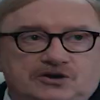
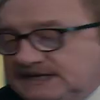

In [14]:
fd.show_embeddings2D(embeddings2D,faces)

In [15]:
from scipy.spatial import distance_matrix

In [19]:
from sklearn.metrics import pairwise_distances

In [20]:
dm = pairwise_distances(embeddings,metric = "cosine")

In [21]:
import plotly.express as px
fig = px.imshow(dm)
fig.show()

In [32]:
np.median(dm)

0.8048473232570009

In [23]:
from sklearn.cluster import DBSCAN,MeanShift

In [85]:
ms = MeanShift(bandwidth = 3.4)

In [86]:
clusters = ms.fit_predict(embeddings)
clusters

array([6, 9, 5, 5, 8, 1, 4, 4, 0, 0, 0, 0, 1, 1, 1, 1, 0, 3, 7, 2, 3, 3,
       2, 2, 2, 0, 0, 0, 0, 0], dtype=int64)

Cluster 0


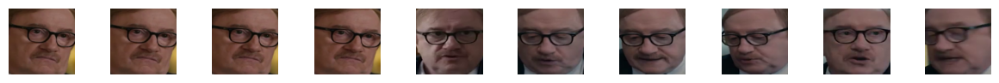

<Figure size 1500x100 with 0 Axes>

Cluster 1


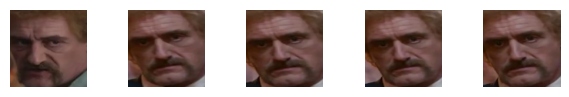

Cluster 2


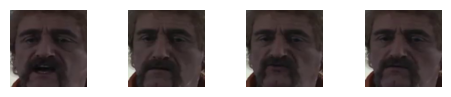

Cluster 3


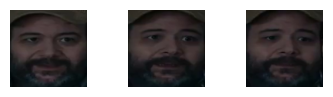

Cluster 4


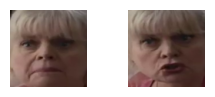

Cluster 5


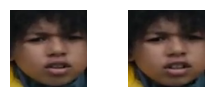

Cluster 6


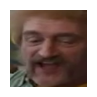

Cluster 7


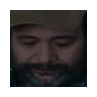

Cluster 8


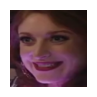

Cluster 9


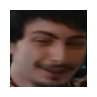

In [87]:
fd.show_faces_by_cluster(faces,clusters)

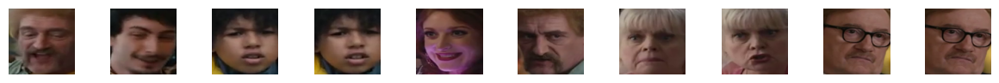

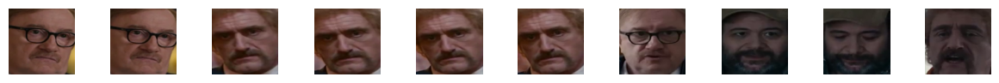

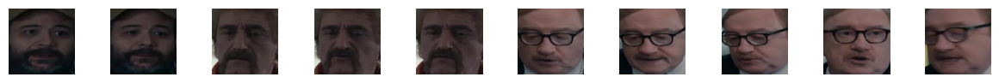

<Figure size 1500x100 with 0 Axes>

In [179]:
fd.show_all_faces(faces)

### Gender with CLIP

In [140]:
from bechdelai.image.clip import CLIP
from bechdelai.image.gender_detection import GenderDetector

In [141]:
gd = GenderDetector()

Loading CLIP model


In [145]:
probas,annotations = gd.predict(faces,faces_metadata)

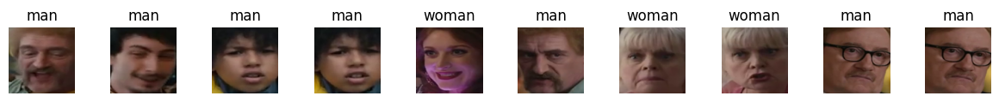

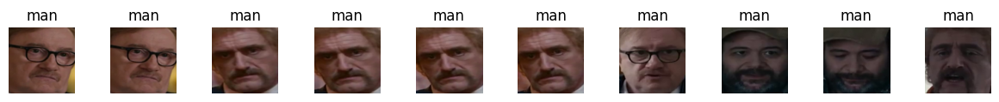

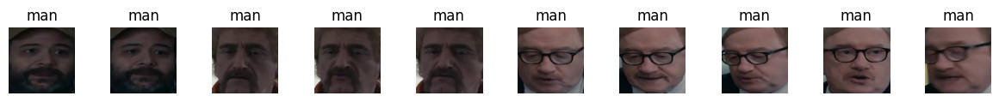

<Figure size 1500x100 with 0 Axes>

In [146]:
fd.show_all_faces(faces,titles = probas["gender"].tolist(),columns = 10)

In [158]:
video.reset_annotations()

In [159]:
video.annotate(annotations)

In [160]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=125), Output()), _dom_classes=…

IntSlider(value=0, max=125)

## Analyzing frames with ViLT

In [203]:
from bechdelai.image.vilt import ViLT

In [204]:
vilt = ViLT()

Loading ViLT model


Downloading:   0%|          | 0.00/251 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/320 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/136k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/470M [00:00<?, ?B/s]

In [313]:
preds,probas = vilt.predict([x.array for x in video.frames],"How many women are in the picture ?")

In [322]:
probas[["0","1","2","3","4"]]["2"].where(lambda x : x > 0.2).dropna()

7     0.423833
9     0.456502
10    0.804312
11    0.854055
14    0.676627
18    0.936626
19    0.824322
20    0.608075
26    0.275406
35    0.641815
36    0.577404
38    0.995854
41    0.657177
50    0.235542
63    0.260603
66    0.264750
67    0.632178
74    0.316406
75    0.312180
78    0.249000
79    0.276363
80    0.704431
82    0.466663
85    0.593414
90    0.327321
91    0.334378
Name: 2, dtype: float32

In [315]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=117), Output()), _dom_classes=…

IntSlider(value=0, max=117)

## Analyzing frames with CLIP

## Analyzing frames with other model from HF Hub

# Playground

In [2]:
from bechdelai.utils.video import extract_frames_from_videos
from bechdelai.vision.video import Video

# Paths

## Trailer

In [241]:
hp_path = r"C:\Users\theo.alvesdacosta\Videos\HP"
print(os.listdir(hp_path))

hp_path = [os.path.join(hp_path,x) for x in os.listdir(hp_path)]
hp4_path = hp_path[2]
hp4_path

["Harry Potter et l'Ordre du Phoenix - Bande Annonce Officielle (VF) - Daniel Radcliffe - Emma Wan.mp4", 'Harry Potter et la Chambre des Secrets - Bande Annonce Officielle (VF) - Daniel Radcliffe.mp4', 'Harry Potter et la Coupe de Feu - Bande Annonce Officielle (VF) - Daniel Radcliffe - Emma Watson.mp4', 'Harry Potter et le Prince de Sang-Mêlé - Bande Annonce Officielle 3 (VF) - Daniel Radcliffe.mp4', "Harry Potter et le Prisonnier d'Azkaban - Bande Annonce Officielle (VF) - Daniel Radcliffe.mp4", 'Harry Potter et Les Reliques de la Mort - Partie 1 - Bande Annonce Officielle (VF).mp4', 'Harry Potter et Les Reliques de la Mort - Partie 2 - Bande Annonce Officielle (VF).mp4', "Harry Potter à l'École des Sorciers - Bande Annonce Officielle (VF) - Daniel Radcliffe.mp4"]


'C:\\Users\\theo.alvesdacosta\\Videos\\HP\\Harry Potter et la Coupe de Feu - Bande Annonce Officielle (VF) - Daniel Radcliffe - Emma Watson.mp4'

## Full movie

In [100]:
video_folder = "C:/Users/theo.alvesdacosta/videos"
hp4_path = "Harry Potter 4 and the Goblet of Fire (et la Coupe de Feu) (2005) 720p VOST by NsX [MKV Corp].mkv"
hp4_path = os.path.join(video_folder,hp4_path)

# Load & prepare images

  0%|          | 0/257 [00:00<?, ?it/s]

  0%|          | 0/257 [00:00<?, ?it/s]

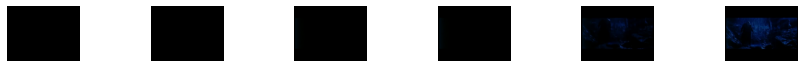

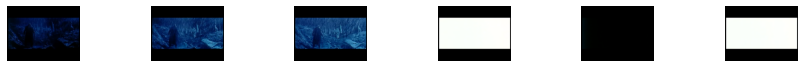

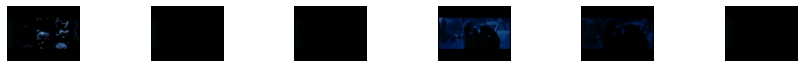

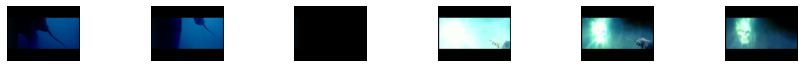

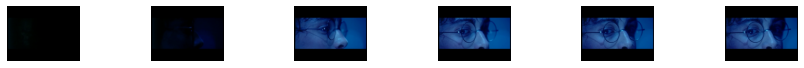

...

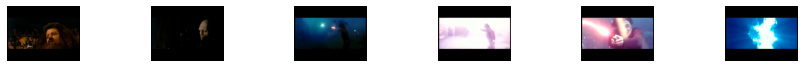

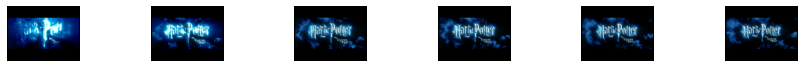

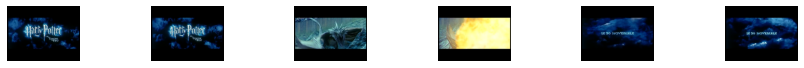

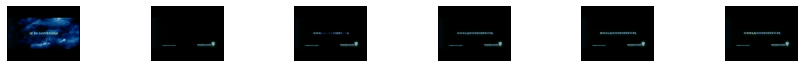

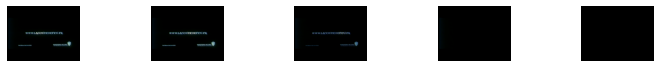

In [244]:
video = Video(path = hp4_path,frame_rate = 2,max_seconds = None)
video.resize(width = 800)
video.show_frames()

In [245]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=256), Output()), _dom_classes=…

IntSlider(value=0, max=256)

# Apply CLIP algorithm

In [246]:
from bechdelai.vision.clip import CLIP

In [247]:
from bechdelai.utils.timeline import convert_to_timeline,fn_timeline

import plotly.express as px

In [248]:
clip = CLIP()

Loading CLIP model


In [273]:
0
46
56
78-81
87
96
106-108
115

0

In [267]:
prompts_dict =  {
    "Base":[
        "background",
        "a black or colored screen with texts",
        "blank",
        "unknown",
        "a blurry picture",
    ],
    "Landscape":[
        'an urban area',
        'a building',
        'a nature landscape',
        'a city street',
        'a school',
        'inside a house',
    ],
    "Romantic":[
        'a woman is undressed, naked, or shown in a sexy way',
        'women breasts',
        'people kissing',
        'couple making love',
    ],
    "Action":[
        "people flying on brooms",
    ],
    "Dialogue":[
        'a young woman',
        'a young man',
        'an old woman',
        'an old man',
        'two women speaking together',
        'two men speaking together',
        'a man and a woman speaking together',
        'a group of persons',
        'a group of men',
        'a group of women',
    ]
}

clip.set_prompts(prompts_dict)

In [268]:
%%time
preds,probas = clip.predict(video)

CPU times: total: 1min 20s
Wall time: 25.5 s


In [269]:
# preds_reduced = clip.reduce_preds_by_category(preds)

In [270]:
# clip.show_preds_area(probas)

In [271]:
def make_fig_frame_probas(probas,i,clip):
    probas_frame = probas.iloc[i].reset_index()
    probas_frame.columns = ["prompt","proba"]
    probas_frame = probas_frame.sort_values("proba",ascending = False)
    probas_frame = probas_frame.merge(clip.prompts,on = "prompt")
    fig = px.bar(probas_frame,x = "prompt",y = "proba",color = "category",category_orders={'prompt': probas_frame["prompt"].tolist()})
    return fig

In [272]:
clip.replay(video,probas)

interactive(children=(Play(value=0, description='Press play', interval=500, max=256), Output()), _dom_classes=…

IntSlider(value=0, max=256)

In [255]:
x = (preds.melt(ignore_index = False)
    .reset_index(drop = False)
    .rename(columns = {"index":"frame_id","variable":"prompt"})
)

x["rank"] = x.groupby(["frame_id"])["value"].transform("rank",ascending = False)

x = x.query("rank<=1")

x = x.merge(clip.prompts,on = "prompt").sort_values("frame_id")

x["sequence_id"] = x.groupby("prompt")["frame_id"].transform(fn_timeline)

timeline = convert_to_timeline(x,"prompt",show = False,xaxis_time=True)
timeline = timeline.merge(clip.prompts,on = "prompt")

In [256]:
fig = px.timeline(timeline,
  x_start = "start",
  x_end = "end",
  color = "prompt",
  y = "category",
#     facet_row = "category",
  color_discrete_sequence = px.colors.qualitative.Alphabet
)
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=-0.5,
    xanchor="right",
    x=1
))
# fig.update_layout(showlegend=False)
fig

In [23]:
from scipy.special import softmax

In [24]:
preds_cat = (preds
 .melt(ignore_index = False)
 .reset_index()
 .rename(columns = {"index":"frame_id","variable":"prompt"})
 .merge(clip.prompts,on = "prompt")
 .groupby(["frame_id","category"]).agg({"value":"max"})["value"]
 .unstack("category")
)

preds_cat = softmax(preds_cat,axis = 1)

In [25]:
preds_for_timeline = preds_cat.melt(ignore_index = False).reset_index().query("value > 0.5")
preds_for_timeline

,frame_id,category,value
0,0,Base,0.960589
1,1,Base,0.953553
2,2,Base,0.938858
3,3,Base,0.967683
4,4,Base,0.960882
...,...,...,...
688,127,Romantic,0.791574
689,128,Romantic,0.767591
718,157,Romantic,0.512598
721,160,Romantic,0.744554


In [29]:
# timeline = convert_to_timeline(
#     preds_for_timeline,
#     "category",
#     show = True,
#     xaxis_time = True,
# )
# timeline

In [27]:
clip.show_preds_area(preds_cat)

In [28]:
clip.replay(video,preds_cat)

interactive(children=(Play(value=0, description='Press play', interval=500, max=186), Output()), _dom_classes=…

IntSlider(value=0, max=186)

# Faces

In [102]:
from bechdelai.vision.faces import FacesDetector

In [103]:
video.extract_faces(backend = "opencv")

  0%|          | 0/946 [00:00<?, ?it/s]

In [106]:
video.faces_metadata.shape

(512, 2)

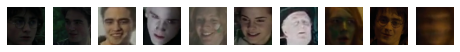

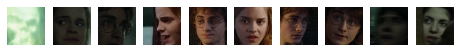

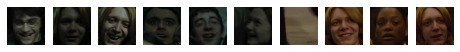

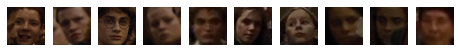

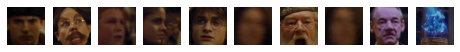

...

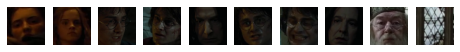

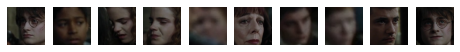

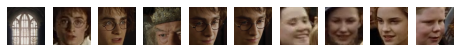

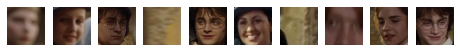

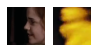

In [104]:
video.show_all_faces()

In [109]:
faces_embedding = video.make_faces_embeddings()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [110]:
faces_embedding.shape

(512, 2622)

In [111]:
from bechdelai.vision.old.face_recognition import FaceAnalyzer

In [112]:
fa = FaceAnalyzer()

In [144]:
n = 1000

In [220]:
%%time
embeddings2D = fa.reduce_embeddings(faces_embedding[:n],n_neighbors=200, min_dist=0.0, n_components=2, metric='cosine')

CPU times: total: 8.41 s
Wall time: 3.69 s



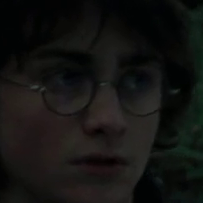
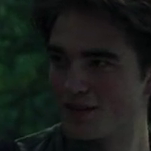
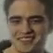
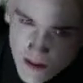
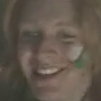
...
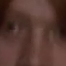
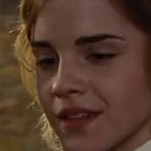
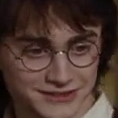
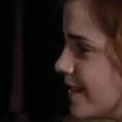
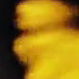

In [240]:
embeddings2D,clusters = fa.cluster_embeddings(embeddings2D,eps = 0.5)
fa.show_embeddings2D(embeddings2D,faces = video.faces[:n])